In [1]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import csv
from sklearn.model_selection import train_test_split
import json
import copy
import math

import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torchvision.transforms import ToTensor
import torchvision.transforms as transforms
import torchvision.transforms.functional as fn

import matplotlib.patches as patches
import albumentations as A
import cv2
import os
from pycocotools import cocoeval, coco
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
import sys, os

from tqdm import tqdm
from torch.optim.lr_scheduler import CosineAnnealingLR, CosineAnnealingWarmRestarts
from warmup_scheduler import GradualWarmupScheduler

import random

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

## Augmentation

In [3]:
Img_size_training = 256
preprocess = A.Compose([
    A.RandomCrop(width=Img_size_training, height=Img_size_training),
], 
bbox_params=A.BboxParams(
    format='pascal_voc', 
    min_area=2000, 
    min_visibility=0.1, 
    label_fields=['category_ids']
    )
)

augumentation = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.2),
    A.ChannelShuffle(p=1),
    A.GaussNoise(p=0.5),
    A.Cutout(p=0.5, num_holes=100, max_h_size=3, max_w_size=3, fill_value=255),
    A.RandomShadow(p=1),
],bbox_params=A.BboxParams(
    format='pascal_voc', 
    min_area=500, 
    min_visibility=0.1, 
    label_fields=['category_ids']
    )
)

/home/user/micromamba/lib/python3.9/site-packages/albumentations/augmentations/dropout/cutout.py:49: FutureWarning: Cutout has been deprecated. Please use CoarseDropout
  warnings.warn(


## visualization function

In [4]:
BOX_COLOR = (255, 0, 0) # Red
TEXT_COLOR = (255, 255, 255) # White
category_id_to_name = {1: 'mitotic', 2: 'not mitotic'}

def visualize_bbox(img, bbox, class_name, color=BOX_COLOR,textcolor=TEXT_COLOR, thickness=2):
    """Visualizes a single bounding box on the image"""
    x_min, y_min, x_max, y_max = bbox
    x_min, y_min, x_max, y_max = int(x_min), int(y_min), int(x_max), int(y_max)
   
    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=color, thickness=thickness)
    
    ((text_width, text_height), _) = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_COMPLEX_SMALL, 0.5, 1)    
    cv2.rectangle(img, (x_min, y_min - int(1.3 * text_height)), (x_min + text_width, y_min), color, -1)
    cv2.putText(
        img,
        text=class_name,
        org=(x_min, y_min - int(0.3 * text_height)),
        fontFace=cv2.FONT_HERSHEY_COMPLEX_SMALL,
        fontScale=0.5, 
        color=textcolor, 
        lineType=cv2.LINE_AA,
    )
    return img


def visualize(image, bboxes, category_ids, category_id_to_name):
    img = image.copy()
    for bbox, category_id in zip(bboxes, category_ids):
        class_name = category_id_to_name[category_id]
        img = visualize_bbox(img, bbox, class_name)
    plt.figure(figsize=(6, 6))
    plt.axis('off')
    plt.imshow(img)

## Data Collection
將官方標注資料轉換成新的標注集gt_labels.json，此後就可以直接使用

In [5]:
def bboxhasErr(box):
    if int(box[0])<0 or int(box[1])<0 or int(box[2])>img_width or int(box[3])>img_height or int(box[0])>=int(box[2]) or int(box[1])>=int(box[3]):
        return True
    else: 
        return False
     

In [6]:
trainset = []
category_id_to_name = {1: 'mitotic', 2: 'not mitotic'}
f = open('MICCAI/cutted_labels/train_gt_labels.json')
data = json.load(f)
labels={}
pre_imgID = 1
img_hasMitoticCell = False

for a in data['annotations']:
    cur_imgID = img_id =  int(a['image_id'])
    if cur_imgID != pre_imgID :
        trainset.append([img_name, img_path,
                        labels[img_id-1]['boxes'],
                        labels[img_id-1]['class_name'],
                        labels[img_id-1]['class_id']])
        pre_imgID = cur_imgID
    img_name = '{:0>4}.png'.format(img_id)
    class_id = int(a['category_id'])
    img_width = data['images'][img_id-1]['width']
    img_height = data['images'][img_id-1]['height']
    class_label = category_id_to_name[class_id]
    img_path = os.path.join('MICCAI/cutted_images/train/{:0>4}.png'.format(img_id))
    box = a['bbox']
    #in case annotation box out of range
    if bboxhasErr(box):
        continue
    else:
        box_info = [int(box[0]), int(box[1]), int(box[2]), int(box[3])]
        if img_id not in labels.keys():
            labels[img_id] = {}
            labels[img_id]['boxes']=[]
            labels[img_id]['class_name']=[]
            labels[img_id]['class_id']=[]
        labels[img_id]['boxes'].append(box_info)
        labels[img_id]['class_name'].append(class_label)
        labels[img_id]['class_id'].append(class_id)

trainset[1]

['0002.png',
 'MICCAI/cutted_images/train/0002.png',
 [[88, 155, 138, 205]],
 ['mitotic'],
 [1]]

In [7]:
test_dataset = []
valid_dataset = []
f = open('MICCAI/cutted_labels/test_gt_labels.json')
data = json.load(f)

for a in data['images']:
    img_id = a['id']
    boxes=[]
    labels=[]
    class_labels=[]
    for annot in data['annotations']:
        if annot['image_id']==img_id:
            boxes.append(annot['bbox'])
            labels.append(annot['category_id'])
            class_labels.append(category_id_to_name[annot['category_id']])
    img_path = os.path.join('MICCAI/cutted_images/test&valid/{:0>4}.png'.format(img_id))
    if len(boxes)>0:
        valid_dataset .append([
            '{:0>4}.png'.format(img_id),
            img_path,
            boxes,
            class_labels,
            labels
        ])
    else:
        test_dataset.append([
            '{:0>4}.png'.format(img_id),
            img_path,
            boxes,
            class_labels,
            labels
        ])

In [8]:
test_dataset[0]
print(len(test_dataset))

586


In [9]:
valid_dataset[0]
print(len(valid_dataset))

414


## Augmentation test

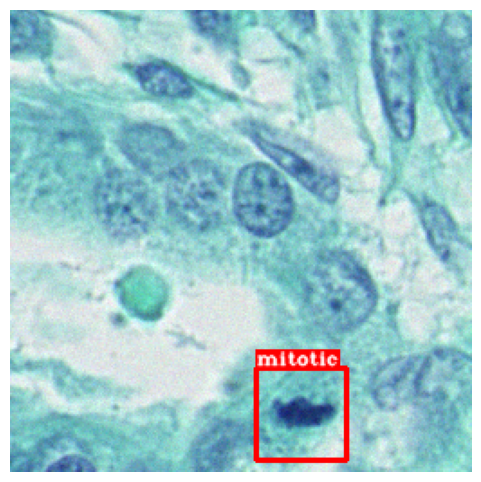

In [10]:
test_imgID = 1
image = cv2.imread('MICCAI/cutted_images/train/{:0>4}.png'.format(test_imgID))
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)


transformed = augumentation(
    image=image, 
    bboxes=trainset[test_imgID-1][2], 
    category_ids=trainset[test_imgID-1][4],
)

img = transformed['image']
boxes = transformed['bboxes']
labels = transformed['category_ids']

visualize(img, boxes, labels, category_id_to_name)


## Cut Image and Save

## Define DataSet class

In [10]:
class Dataset(Dataset):
    def __init__(self, data,transform=None, istrained=True, isvalided=False):
        self.images_path = []
        self.img_ids = []
        self.boxes = []
        self.class_id = []
        self.transform = transform
        self.istrained = istrained
        self.isvalided = isvalided
        self.meanList = []
        self.stdList = []
        for i in data:
            self.img_ids.append(i[0])
            self.images_path.append(i[1])
            self.boxes.append(i[2])
            self.class_id.append(i[4])


    
    def __len__(self):
        return len(self.images_path)
    
    def __getitem__(self, idx):
        # print(self.images_path[idx])
        boxes = self.boxes[idx]
        labels = self.class_id[idx]
        img = cv2.imread(self.images_path[idx])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


        img = np.array(img, dtype=np.uint8)

        if self.istrained==True and self.isvalided==False:
            transformed = augumentation(
                image=img, 
                bboxes=boxes, 
                category_ids=labels,
            )

            img = transformed['image']
            boxes = transformed['bboxes']
            labels = transformed['category_ids']
        
        
        target = {}
        # if self.istrained==True:
        boxes = np.array(boxes)
        labels = np.array(labels)
        boxes = torch.from_numpy(boxes).to(torch.float32)
        # boxes = boxes.squeeze(0)
        labels = torch.from_numpy(labels).to(torch.int64)
        # labels = labels.squeeze(0)
 

        target['boxes'] = boxes
        target['labels'] = labels
        
        
       
        img= self.transform(img)
        mean, std = img.mean([1,2]), img.std([1,2])
        img = fn.normalize(img, mean=mean, std=std)
        
        if self.istrained==False:
            target['img_id'] = self.img_ids[idx]
            target['mean'] = mean
            target['std'] = std

        return img, target

In [11]:
train_transforms= transforms.Compose([
    transforms.ToTensor(),
])

BATCH_SIZE = 2

def collate_fn(batch):
    return tuple(zip(*batch))
#image from valid_dataset are mitotic, half of them assign to test_dataset
valid, test = train_test_split(valid_dataset, random_state=42, train_size=0.6)  
test = test_dataset + test

train_set = Dataset(trainset, train_transforms, True)
valid_set = Dataset(valid, train_transforms, True, True)
test_set = Dataset(test, train_transforms, False)
train_loader = DataLoader(dataset=train_set, batch_size=BATCH_SIZE, shuffle=True,collate_fn=collate_fn, num_workers=6, drop_last=True)
valid_loader = DataLoader(dataset=valid_set, batch_size=BATCH_SIZE, shuffle=True,collate_fn=collate_fn, num_workers=6, drop_last=True)
test_loader = DataLoader(dataset=test_set, batch_size=BATCH_SIZE, shuffle=True,collate_fn=collate_fn, num_workers=0)
print(f'There are {len(train_loader)} training batches, {len(valid_loader)} valid batches , and {len(test_loader)} test batches.')

There are 1264 training batches, 124 valid batches , and 376 test batches.


# Model declaration

In [12]:
from torchvision.models.detection import FCOS, fcos_resnet50_fpn
import torchvision
from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.models.detection.fcos import FCOS_ResNet50_FPN_Weights
from torchvision.models.detection.backbone_utils import _resnet_fpn_extractor, _validate_trainable_layers
from torchvision.ops.feature_pyramid_network import LastLevelP6P7
from torchvision.models.resnet import resnet152,ResNet152_Weights, resnext101_64x4d, resnet18
from torch import nn, Tensor

## Resnext101

In [13]:
def fcos_resnext101_fpn(
    weights=  None,
    progress= True,
    num_classes= 2,
    weights_backbone  = None,
    trainable_backbone_layers = None,
)-> FCOS:

    is_trained = weights is not None or weights_backbone is not None
    trainable_backbone_layers = _validate_trainable_layers(is_trained, trainable_backbone_layers, 5, 3)
    norm_layer = nn.BatchNorm2d

    backbone = resnext101_64x4d(weights=weights_backbone, progress=progress, norm_layer=norm_layer)
    backbone = _resnet_fpn_extractor(
        backbone, trainable_backbone_layers, returned_layers=[2, 3, 4], extra_blocks=LastLevelP6P7(256, 256)
    )
    backbone.out_channels = 256
    model = FCOS(
        backbone,
        num_classes=num_classes,
        detections_per_img = 10,
        topk_candidates = 10,
        score_thresh=0.5,
        nms_thresh=0.5,

    )
    if weights is not None:
        model.load_state_dict(weights.get_state_dict(progress=progress))

    return model

model = fcos_resnext101_fpn(num_classes=2, )
model = model.to(device)

## Resnet152

## Resnet50

## Resnet18

# Before Training
prepare some useful function to calculate loss and validate model

In [14]:
class Averager:      ##Return the average loss 
    def __init__(self):
        self.current_total = 0.0
        self.iterations = 0.0

    def send(self, value):
        self.current_total += value
        self.iterations += 1

    @property
    def value(self):
        if self.iterations == 0:
            return 0
        else:
            return 1.0 * self.current_total / self.iterations

    def reset(self):
        self.current_total = 0.0
        self.iterations = 0.0

## validate function

In [15]:
def my_summarize( cocoEvalObj,ap=1, iouThr=None, areaRng='all', maxDets=100 ):
            p = cocoEvalObj.params
            aind = [i for i, aRng in enumerate(p.areaRngLbl) if aRng == areaRng]
            mind = [i for i, mDet in enumerate(p.maxDets) if mDet == maxDets]
            if ap == 1:
                # dimension of precision: [TxRxKxAxM]
                s = cocoEvalObj.eval['precision']
                # IoU
                if iouThr is not None:
                    t = np.where(iouThr == p.iouThrs)[0]
                    s = s[t]
                s = s[:,:,:,aind,mind]
            else:
                # dimension of recall: [TxKxAxM]
                s = cocoEvalObj.eval['recall']
                if iouThr is not None:
                    t = np.where(iouThr == p.iouThrs)[0]
                    s = s[t]
                s = s[:,:,aind,mind]
            if len(s[s>-1])==0:
                mean_s = -1
            else:
                mean_s = np.mean(s[s>-1])
            return mean_s

def pascal2coco(box):
    return_box=[]
    return_box.append(box[0])
    return_box.append(box[1])
    return_box.append(box[2]-box[0])
    return_box.append(box[3]-box[1])
    return return_box

        
class HiddenPrints:
    def __enter__(self):
        self._original_stdout = sys.stdout
        sys.stdout = open(os.devnull, 'w')

    def __exit__(self, exc_type, exc_val, exc_tb):
        sys.stdout.close()
        sys.stdout = self._original_stdout

In [16]:
def valid(model, valid_loader, valid_loss_hist=None):
    #validation
    COCODt = dict()
    COCODt['images']=list()
    COCODt['annotations'] = list()
    COCODt['categories'] = data['categories']
    annotDt_count=1

    COCOgt = dict()
    COCOgt['images']=list()
    COCOgt['annotations'] = list()
    COCOgt['categories'] = data['categories']
    annotGt_count=1
    
    with torch.no_grad():
        img_count=1
        if valid_loss_hist != None:
            valid_loss_hist.reset()
        for images, targets in (valid_loader):
            images_infer = list(image.to(device) for image in images)
            ##################
            if valid_loss_hist != None:
                targets_infer = [{k: v.to(device) for k, v in t.items()} for t in targets] 
                model.train()
                for module in model.modules():
                    if isinstance(module, nn.BatchNorm2d):
                        module.eval()
                loss_valid = model(images_infer, targets_infer)   ##Return the loss
                losses_valid = sum(loss for loss in loss_valid.values())
                loss_value_valid = losses_valid.item()

                valid_loss_hist.send(loss_value_valid)  
            #################
            model.eval()
            outputs = model(images_infer)
            
            for i in range(len(images)):
                img = images[i].permute(1,2,0).cpu().numpy().squeeze()
                boxes_gt = targets[i]['boxes'].data.cpu().numpy().tolist()
                class_ids_gt = targets[i]['labels'].data.cpu().numpy().tolist()
                boxes_pred = outputs[i]['boxes'].data.cpu().numpy().tolist()
                labels_pred = outputs[i]['labels'].data.cpu().numpy().tolist()
                scores_pred = outputs[i]['scores'].data.cpu().numpy().tolist()
                for i in range(len(boxes_pred)):
                    box = pascal2coco(boxes_pred[i])
                    each_annot = {
                        'bbox':box,
                        'category_id':labels_pred[i],
                        'image_id': img_count,
                        'id': annotDt_count,
                        'score': scores_pred[i],
                        'iscrowd': 0,
                        'area': box[2]*box[3],

                    }
                    COCODt['annotations'].append(each_annot)
                    annotDt_count+=1

                for i in range(len(boxes_gt)):
                    box = pascal2coco(boxes_gt[i])
                    each_annot = {
                        'bbox':box,
                        'category_id':class_ids_gt[i],
                        'image_id': img_count,
                        'id': annotGt_count,
                        'iscrowd': 0,
                        'area': box[2]*box[3],
                    }
                    COCOgt['annotations'].append(each_annot)
                    annotGt_count+=1

                each_image = {
                            'id': img_count,
                            'width': Img_size_training,
                            'height': Img_size_training,
                        }
                COCOgt['images'].append(each_image)
                COCODt['images'].append(each_image)
                img_count+=1



        with open("MICCAI/cutted_labels/COCOgt.json", "w") as outfile:
            json.dump(COCOgt, outfile)
            outfile.close()

        with open("MICCAI/cutted_labels/COCOdt.json", "w") as outfile:
            json.dump(COCODt, outfile)
            outfile.close()
            
        with HiddenPrints():
            cocoGt=coco.COCO('MICCAI/cutted_labels/COCOgt.json')
            cocoDt=coco.COCO('MICCAI/cutted_labels/COCOdt.json')
            imgIds=sorted(cocoGt.getImgIds())
            imgIds=imgIds[0:img_count-1]
            imgId = imgIds[np.random.randint(img_count-1)]
            annType = ['segm','bbox','keypoints']
            annType = annType[1]
            cocoEval = COCOeval(cocoGt,cocoDt,annType)
            cocoEval.params.imgIds  = imgIds
            cocoEval.evaluate()
            cocoEval.accumulate()
            Precision = my_summarize(cocoEvalObj=cocoEval,ap=1)#mAp 0.5:0.95
            Recall = my_summarize(cocoEvalObj=cocoEval,ap=0) #recall
            f1 = (2*(Precision*Recall))/(Precision+Recall)
        if valid_loss_hist != None:
            return {'mAP':Precision, 'f1':f1, 'mAR': Recall, 'loss': valid_loss_hist.value}
        else:
            return {'mAP':Precision, 'f1':f1, 'mAR': Recall}
    
    

## Start training

46e8cd0e17b12d3d1b28a537603b6e8cb3407cfa

In [17]:
import wandb
wandb.login()

wandb: Currently logged in as: leo900223. Use `wandb login --relogin` to force relogin


True

In [18]:
LR = 1e-2
WEIGHT_DECAY = 1e-6
optimizer = optim.Adam(model.parameters(),lr = LR, weight_decay=WEIGHT_DECAY)
EPOCHS = 50
warm_up_epoches = 5
loss_hist = Averager()
valid_loss_hist = Averager()
#scheduler
# lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer,step_size=20, gamma=0.1, verbose=False)
scheduler_steplr = CosineAnnealingWarmRestarts(optimizer, 3, T_mult=2, eta_min=2e-4, last_epoch=-1, verbose=False)
scheduler_warmup = GradualWarmupScheduler(optimizer, multiplier=1, total_epoch=warm_up_epoches, after_scheduler=scheduler_steplr)



def Train():
    model.train()
    optimizer.zero_grad() #avoid warning message, should call optim.step() before scheduler_warmup.step()
    optimizer.step()
    min_loss=100
    for epoch in range(0,EPOCHS):
        loss_hist.reset()
        tot_loss = 0
        model.train()
        loop = tqdm(enumerate(train_loader), total=len(train_loader))
        loop.set_description(f"Epoch [{epoch+1}/{EPOCHS}]")
        scheduler_warmup.step()
        for batch_idx, (images, targets) in loop:
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets] 
            images = list(image.to(device) for image in images)
            optimizer.zero_grad()
            loss_dict = model(images, targets)   ##Return the loss

            losses = sum(loss for loss in loss_dict.values())
            loss_value = losses.item()

            loss_hist.send(loss_value)  #Average out the loss
            losses.backward()
            optimizer.step()
            loop.set_postfix(loss = loss_hist.value)
            
        
        #validate model
        valid_result = valid(model, valid_loader, valid_loss_hist)
        wandb.log({
            "train-loss": loss_hist.value, 
            "mAP": valid_result['mAP'], 
            "lr": optimizer.param_groups[0]['lr'], 
            "F1":valid_result['f1'],
            "mAR": valid_result['mAR'],
            "valid-loss": valid_result['loss']
        })
        
        if valid_result['loss']<min_loss:
            torch.save(model.state_dict(), 'MICCAI/models/FCOS/ResNet50/0316-1.pth') #
            min_loss = valid_result['loss']

        

        
        
        
        


In [ ]:
wandb.init(
    # set the wandb project where this run will be logged
    project="mitosis_detection",
    # track hyperparameters and run metadata
    config={
    "learning_rate": LR,
    "architecture": "FCOS_resnext101",
    "dataset": "MIDOG2022",
    "epochs": EPOCHS,
    "warmup": warm_up_epoches,
    }
)
Train()
wandb.finish()



Epoch [1/50]: 100%|██████████████| 1264/1264 [14:11<00:00,  1.48it/s, loss=2.25]
/tmp/ipykernel_336/1427728485.py:105: RuntimeWarning: invalid value encountered in double_scalars
  f1 = (2*(Precision*Recall))/(Precision+Recall)
Epoch [2/50]:  25%|███▊           | 316/1264 [03:35<10:53,  1.45it/s, loss=1.94]

# Evaluation
using coco tools to evaluate the model

In [21]:
# model = fcos_resnext101_fpn(num_classes=3, )
# model.load_state_dict(torch.load('MICCAI/models/FCOS/ResNext101/50ep_x5.pth',map_location=torch.device(device)), )

# model = model.to(device)

In [21]:
COCODt = dict()
COCODt['images']=list()
COCODt['annotations'] = list()
COCODt['categories'] = data['categories']
annotDt_count=1

COCOgt = dict()
COCOgt['images']=list()
COCOgt['annotations'] = list()
COCOgt['categories'] = data['categories']
annotGt_count=1


with torch.no_grad():
    img_count=1
    model.eval()
    for images, targets in (test_loader):
        images_infer = list(image.to(device) for image in images)
        outputs = model(images_infer)
        for i in range(len(images)):
            # img_id = targets[i]['img_id']
            img = images[i].permute(1,2,0).cpu().numpy().squeeze()
            boxes_gt = targets[i]['boxes'].data.cpu().numpy().tolist()
            class_ids_gt = targets[i]['labels'].data.cpu().numpy().tolist()
            boxes_pred = outputs[i]['boxes'].data.cpu().numpy().tolist()
            labels_pred = outputs[i]['labels'].data.cpu().numpy().tolist()
            scores_pred = outputs[i]['scores'].data.cpu().numpy().tolist()
            for i in range(len(boxes_pred)):
                box = pascal2coco(boxes_pred[i])
                each_annot = {
                    'bbox':box,
                    'category_id':labels_pred[i],
                    'image_id': img_count,
                    'id': annotDt_count,
                    'score': scores_pred[i],
                    'iscrowd': 0,
                    'area': box[2]*box[3],

                }
                COCODt['annotations'].append(each_annot)
                annotDt_count+=1
                    
            for i in range(len(boxes_gt)):
                box = pascal2coco(boxes_gt[i])
                each_annot = {
                    'bbox':box,
                    'category_id':class_ids_gt[i],
                    'image_id': img_count,
                    'id': annotGt_count,
                    'iscrowd': 0,
                    'area': box[2]*box[3],
                }
                COCOgt['annotations'].append(each_annot)
                annotGt_count+=1
            
            each_image = {
                        # 'file_name':img_id,
                        'id': img_count,
                        'width': Img_size_training,
                        'height': Img_size_training,
                    }
            COCOgt['images'].append(each_image)
            COCODt['images'].append(each_image)
            img_count+=1

            
    
    with open("MICCAI/cutted_labels/COCOgt.json", "w") as outfile:
        json.dump(COCOgt, outfile)
        outfile.close()
        
    with open("MICCAI/cutted_labels/COCOdt.json", "w") as outfile:
        json.dump(COCODt, outfile)
        outfile.close()

        
cocoGt=coco.COCO('MICCAI/cutted_labels/COCOgt.json')
cocoDt=coco.COCO('MICCAI/cutted_labels/COCOdt.json')
imgIds=sorted(cocoGt.getImgIds())
imgIds=imgIds[0:img_count-1]
imgId = imgIds[np.random.randint(img_count-1)]
annType = ['segm','bbox','keypoints']
annType = annType[1]
cocoEval = COCOeval(cocoGt,cocoDt,annType)
cocoEval.params.imgIds  = imgIds
cocoEval.evaluate()
cocoEval.accumulate()
cocoEval.summarize()

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.04s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.650
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.607
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.493
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.717
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.755
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | max

In [22]:
valid_result = valid(model, test_loader)
valid_result

{'mAP': 0.49347084663035196,
 'f1': 0.5968337777039436,
 'mAR': 0.7549707602339181}

# 顯示影像

In [23]:
def visualize_test(image, bboxes_gt, bboxes, category_ids_gt, category_ids, category_id_to_name):
    img = image.copy()
    

    for bbox, category_id in zip(bboxes, category_ids):
        class_name = category_id_to_name[category_id]   
        img = visualize_bbox(img, bbox, class_name,(255, 0, 0), (255, 255, 255))

    for bbox, category_id in zip(bboxes_gt, category_ids_gt):
        class_name = category_id_to_name[category_id]
        img = visualize_bbox(img, bbox, class_name,(124,252,0),(0,0,0), 1)
    plt.figure(figsize=(3, 3))
    plt.axis('off')
    plt.imshow(img)
    

/tmp/ipykernel_28392/1170950380.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, 15, figsize=(24, 10))


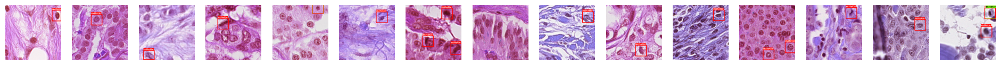

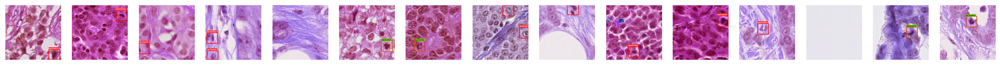

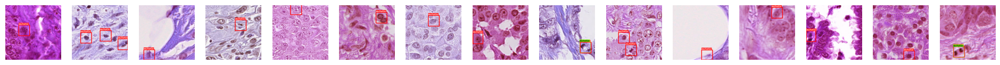

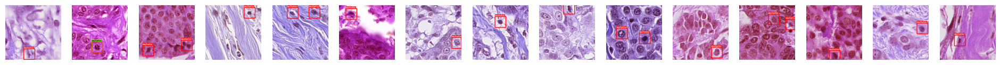

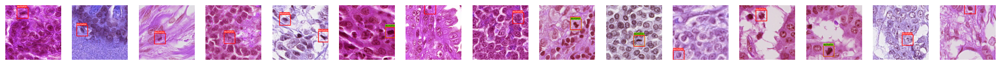

...

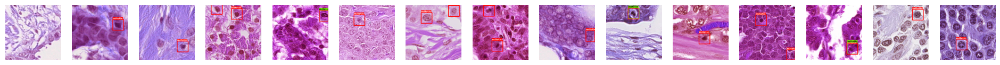

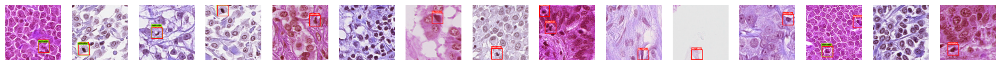

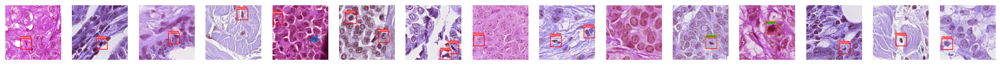

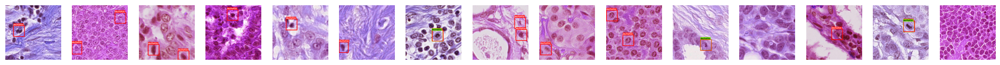

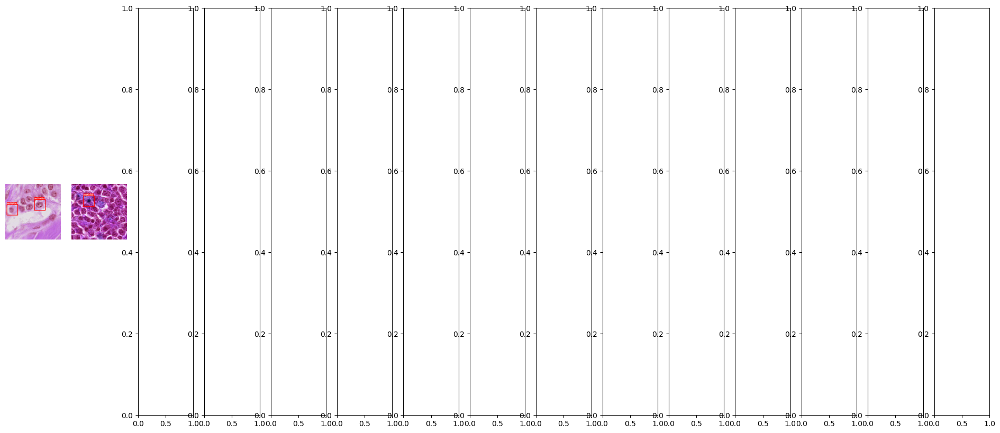

In [25]:

def inverse_normalize(tensor, mean, std):
    inv_normalize = transforms.Normalize(
       mean= [-m/s for m, s in zip(mean, std)],
       std= [1/s for s in std]
    )
    
    inv_tensor = inv_normalize(tensor)
    return inv_tensor

with torch.no_grad():
    img_count=0
    model.eval()
    for images, targets in (test_loader):
        images_infer = list(image.to(device) for image in images)
        outputs = model(images_infer)
        fig, ax = plt.subplots(1, 15, figsize=(24, 10))
        for i in range(len(images)):
            # image = images[i].permute(1,2,0).cpu().numpy().squeeze()
            image = images[i]
            boxes_gt = targets[i]['boxes'].data.cpu().numpy().tolist()
            class_ids_gt = targets[i]['labels'].data.cpu().numpy().tolist()
            mean = targets[i]['mean']
            std = targets[i]['std']
            boxes_pred = outputs[i]['boxes'].data.cpu().numpy().tolist()
            labels_pred = outputs[i]['labels'].data.cpu().numpy().tolist()
            scores_pred = outputs[i]['scores'].data.cpu().numpy().tolist()
            
            image = inverse_normalize(image, mean=mean, std=std)
            image = image.permute(1,2,0).cpu().numpy().squeeze()
            img = image.copy()
            img = np.uint8(img*255)
            for bbox, category_id in zip(boxes_pred, labels_pred):
                class_name = category_id_to_name[category_id]
                img = visualize_bbox(img, bbox, class_name,(255, 0, 0), (255, 255, 255))

            for bbox, category_id in zip(boxes_gt, class_ids_gt):
                class_name = category_id_to_name[category_id]
                img = visualize_bbox(img, bbox, class_name,(124,252,0),(0,0,0), 1)
            
            ax[i].set_axis_off()
            ax[i].imshow(img)
            # visualize_test(
            #     img,
            #     boxes_gt,
            #     boxes_pred,
            #     class_ids_gt,
            #     labels_pred,
            #     category_id_to_name,
            # )
            